#  What Make Us Happy? Can money buy happiness?
> Although happiness is a state of mind and a subjective experience, there are some common factors that contribute to happiness across cultures and individuals. It's originated from one of the United Nation's resolution, the annual publication of the World Happiness Report that ranks countries based on their citizens' self-reported well-being and happiness levels to provide insights from six factors to measure happiness, including GDP per capita, social support, life expectancy, freedom to make life choices, generosity, and perceptions of corruption.
> The intent is to use the World Happiness Report datasets to explore the factors that contribute to happiness in different countries and regions.

## Visualization Techniques

> The dashboard utilizes a variety of visualization techniques to effectively communicate insights from the World Happiness Report data. Each technique is chosen based on its ability to convey specific information and facilitate user exploration.

> For distribution and modality of the data:
- **Histogram**: to present the distribution of happiness factors with various scales effectively, I use histograms with KDE (Kernel Density Estimate) plots. this approach shows both the distribution and density of each factor. Additionally the KDE curves help visualization of modality.
- **Box Plot**: visualization of the extremes and quartiles distribution of happiness factors across different countries and regions. They highlight the median, interquartile range, and potential outliers. It also compares distributions among multiple factors, identifying skewness, and understanding the variability within the data.

> For relationships and correlations:
- **Pair Plot**: Used to visualize the relationships between different factors and happiness scores. It provides scatter plots for each pair of variables, along with histograms or KDE plots on the diagonal. This helps identifying correlations, trends, and patterns between multiple factors
- **Correlation Matrix**: Used to visualize the correlation between different factors and happiness scores. It provides a color-coded representation of correlation values, making it easy to identify strong and weak relationships. The matrix format allows for quick comparisons between multiple variables, highlighting both positive and negative correlations.

> For analysis and comparison:
Ultimately, the dashboard is aimed to provide visual insightst into the factors that contribute to happiness across different countries and regions. The following techniques are used for analysis and comparison:
- **Radar Chart**: Used to visualize which factors explain the happiness scores and factors for different countries and regions. They provide a multi-dimensional view of how each factor contributes to overall happiness, as well as identifying patterns across different happiness factors. 
- **Polar Chart**: Due to various range in the variables, I attempted to normalize factors data and further explore the factors that contribute to happiness in different countries and regions. Identifying the most significant factors and their relative importance in determining happiness scores. 
- **Scatter Plots**: Used to visualize the relationship between different factors and happiness scores.


> Each visualization type has its unique perspective and purpose, Histograms and box plots help in understanding the distribution and variability, while pair plots and correlation matrices reveal relationships and correlations. Radar charts and polar charts offer multi-dimensional views, and heatmaps and scatter plots highlight patterns and trends.

> The interactivity options are provided via Plotly - tooltips, zooming, and filtering enhance the user experience. For charts that represnet 150+ countries, I used Plotly to provide interactivity for selecting the country of interest for better exploration.

## Visualization Libraries

> The visualization libraries used in this notebook includes, **Matplotlib**, **Seaborn**, **Plotly** and **Plotly Express**. For the interactive charts, I used Plotly and Plotly Express to create interactive visualizations that allow users to explore the data in more detail. The interactivity options include tooltips, zooming, and filtering, which enhance the user experience and make it easier to understand the data. For example the dataset contains 150+ countries, I used Plotly to provide interactivity for selecting the country of interest for better exploration. **Plotly** was created by the company Plotly Inc. It is free and open-source software, licensed under the MIT license. The source code, report issues, or contribute is available on [GitHub](https://plotly.com/python/).

> I choose **Plotly** and **Plotly Express** for the following reasons:
- **Ease of Use**: Plotly Express is a high-level interface for creating visualizations. It provides similiar experience to Matplotlib.
- **Wide Range of Chart Types**: Plotly supports a variety of chart types, including polar charts, and geographical maps.
- **Integration with Jupyternotbook**: Plotly integrated with JupyterNotebook, which is my target environment for data analysis and visualization. 

### Installation:

You can install Plotly using pip or conda:

- **Using pip**:
  ```bash
  pip install plotly
  ```

- **Using conda**:
  ```bash
  conda install -c conda-forge plotly
  ```





## Data Preparation

### Data Sources
- [Kaggle 2015-2019](https://www.kaggle.com/datasets/unsdsn/world-happiness)
  - This is the original dataset from the World Happiness Report, which contains data from 2015 to 2019. It includes information about happiness scores and factors for different countries and regions. use this dataset as a reference to remove duplicates. 
- [Kaggle 2015-2023](https://www.kaggle.com/datasets/sazidthe1/global-happiness-scores-and-factors)
  - World Happiness Report 2015-2023 dataset
- [Kaggle 2024](https://www.kaggle.com/datasets/ajaypalsinghlo/world-happiness-report-2024)
  - World Happiness Report 2024 dataset
- [ISO 3166](https://github.com/lukes/ISO-3166-Countries-with-Regional-Codes)
  - Country name, ISO 3166-1 alpha-2 code, and ISO 3166-1 alpha-3 code, use to validate the country names and regions in the dataset.

> Downloaded above mentioned datasets and extraced/saved them to the `assets` folder. The datasets are in CSV format and contain information about happiness scores and factors for different countries and regions. The intention is to read and combine these datasets to create a multiple-year from 2015 to 2024 dataset for analysis. 

### Data Cleaning
> Primarily the source of the data is [Kaggle 2015-2023](https://www.kaggle.com/datasets/sazidthe1/global-happiness-scores-and-factors) and [Kaggle 2024](https://www.kaggle.com/datasets/ajaypalsinghlo/world-happiness-report-2024) which contains the most recent data. However, the 2015-2023 dataset contains duplicates rows for some countries, so I use the 2015-2019 dataset as a reference to validate and remove the duplicates. 


#### Read the csv files (assets/WHR_*.csv), add a Year column, and concatenate into a single DataFrame
> The 2024 csv file was renamed to WHR_2024.csv to conform to the naming convention of the other files.
> the ISO 3166 csv file was renamed from all.csv to iso3166.csv. It will be load into a dataframe to lookup region name in case it is missing from the dataset.

In [1]:
# Load the data from assets/WHR_*.csv, add a year column, and concatenate into a single DataFrame

import glob
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

data_file_path = "assets/WHR_*.csv"
csv_files = sorted(glob.glob(data_file_path))
print(csv_files)
df_list = []
for i, file in enumerate(csv_files):
    df = pd.read_csv(file)
    year = file.split('_')[-1].split('.')[0]  # Extract year from filename
    df['Year'] = int(year)
    df_list.append(df)

# Load ISO3166 data from assets/iso3166.csv - this file should contain country codes and names
iso3166_df = pd.read_csv('assets/iso3166.csv')

['assets/WHR_2015.csv', 'assets/WHR_2016.csv', 'assets/WHR_2017.csv', 'assets/WHR_2018.csv', 'assets/WHR_2019.csv', 'assets/WHR_2020.csv', 'assets/WHR_2021.csv', 'assets/WHR_2022.csv', 'assets/WHR_2023.csv', 'assets/WHR_2024.csv']


#### Define functions for handle mismatched column names and missing Region values

In [2]:
# this function will be used to map country names to regions
# first it will check the country_region_map dictionary, if not found it will check the iso3166_df DataFrame
# the country_region_map dictionary is populated with the country names and regions from loading the 2015-2024 data
def get_country_region(country_name):
    region = country_region_map.get(country_name)
    if region:
        return region
    region = iso3166_df.loc[iso3166_df['name'].str.contains(country_name, na=False), 'region']
    if not region.empty:
        return region.values[0]
    else:
        return None

# Load the happiness data from assets/WHR_*.csv
# add a year column, and concatenate into a single DataFrame
# handling the 2024 data separately as it has different column names
# and missing region information
country_region_map = {}
def load_happiness_data():
    dfs = []
    
    for file in csv_files:
        df = pd.read_csv(file)
        year = int(file.split('_')[-1].split('.')[0])
        df['Year'] = year
        # print(f"Year: {year}, Row Count: {df.shape[0]}")
          
        if year == 2024:
            df.rename(columns={
                'Country name': 'country',
                'Ladder score': 'happiness_score',
                'Explained by: Log GDP per capita': 'gdp_per_capita',
                'Explained by: Social support': 'social_support',
                'Explained by: Healthy life expectancy': 'healthy_life_expectancy',
                'Explained by: Freedom to make life choices': 'freedom_to_make_life_choices',
                'Explained by: Generosity': 'generosity',
                'Explained by: Perceptions of corruption': 'perceptions_of_corruption',
            }, inplace=True)
            df.drop(columns=['upperwhisker', 'lowerwhisker','Dystopia + residual'], inplace=True)
            df['region'] = None
        else:
          new_entries = df[['country', 'region']].set_index('country').to_dict()['region']
          country_region_map.update({k: v for k, v in new_entries.items() if k not in country_region_map})

                
        if df['region'].isnull().all() or df['region'].eq('').all():
            df['region'] = df['country'].apply(get_country_region)
                
        dfs.append(df)
    
    final_df = pd.concat(dfs, ignore_index=True)
    
    return final_df


#### Basic verification and handling duplicates and missing values
> First check the number of rows in the concatenated DataFrame should match the csv files total row counts.

> Check for missing values before dropping rows for missing values 
```python
uae = data[data['country'].str.contains('United Arab Emirates', na=False)]
palestine = data[data['country'].str.contains('State of Palestine', na=False)]
bahrain = data[data['country'].str.contains('Bahrain', na=False)]
tajikistan = data[data['country'].str.contains('Tajikistan', na=False)]
```
> If there are any duplicates or missing values, they should be handled before proceeding with the analysis.


In [3]:
def count_lines_in_files(file_paths):
    total_lines = 0
    for file_path in file_paths:
        with open(file_path, 'r') as file:
            lines = file.readlines()
            total_lines += len(lines)
    return total_lines

file_row_count = count_lines_in_files(csv_files) - len(csv_files)  # Subtract header lines
print(f"Total lines in files: {file_row_count}")

happiness_data = load_happiness_data()
print(f"Total rows in dataframe: {happiness_data.shape[0]}")

assert happiness_data.shape[0] == file_row_count, "Row count mismatch between files and DataFrame"


rows_with_missing_values = happiness_data[happiness_data.isnull().any(axis=1)]

print(f"Rows with missing values: {rows_with_missing_values.shape[0]}")
print(f"{rows_with_missing_values[['country','Year', 'happiness_score']]}")


print(happiness_data.isna().sum())

Total lines in files: 1510
Total rows in dataframe: 1510
Rows with missing values: 5
                   country  Year  happiness_score
489   United Arab Emirates  2018            6.774
1328    State of Palestine  2023            4.908
1428               Bahrain  2024            5.959
1454            Tajikistan  2024            5.281
1469    State of Palestine  2024            4.879
country                         0
region                          0
happiness_score                 0
gdp_per_capita                  3
social_support                  3
healthy_life_expectancy         4
freedom_to_make_life_choices    3
generosity                      3
perceptions_of_corruption       4
Year                            0
dtype: int64


#### Check for duplicates

> Found the duplicates are multiple rows in 2018 and 2019 for Cyprus, Use the 2015-2019 dataset as a reference to troubleshoot the duplicates. 
The duplicates are caused by North Cyprus being listed as Cyprus. Located the rows in source data files and made corrections manually. 
Below is the code to check for duplicates and confirm the changes indeed removed the duplicates. 
```python
duplicates = happiness_data[happiness_data.duplicated(subset=['Year', 'country'], keep=False)]
print(f"Duplicates found: {duplicates.shape[0]}")
duplicates 

# Edit the source data to 
test = happiness_data.loc[happiness_data['country'].str.contains('North Cyprus', na=False)]
test

duplicates = happiness_data[happiness_data.duplicated(subset=['Year', 'country'], keep=False)]
print(f"Duplicates found: {duplicates.shape[0]}")
duplicates 
```

#### Finalize removing of missing values and duplicates to have a clean dataset
> Reviewed data with missing values, they have happiness scores so the intuition is to impute the missing values with the mean of the same country. However, for Palestine, there were no prior data, so we will use regional mean for the missing values. 

In [4]:
columns_to_fill = [
    'gdp_per_capita',
    'social_support',
    'healthy_life_expectancy',
    'freedom_to_make_life_choices',
    'generosity',
    'perceptions_of_corruption'
]

# Fill NA values with the mean of the column for the same country
for column in columns_to_fill:
    happiness_data[column] = happiness_data.groupby('country')[column].transform(lambda x: x.fillna(x.mean()))

print(happiness_data.isna().sum())

rows_with_missing_values = happiness_data[happiness_data.isnull().any(axis=1)]
print(f"Rows with missing values: {rows_with_missing_values[['country','Year']].head(10)}")

for index, row in rows_with_missing_values.iterrows():
    for column in columns_to_fill:
        if pd.isna(row[column]):
            print(f"Row {index}, Column '{column}' has a missing value.")         
            happiness_data[column] = happiness_data.groupby('region')[column].transform(lambda x: x.fillna(x.mean()))

# Check if there are any missing values left
print(happiness_data.isna().sum())


country                         0
region                          0
happiness_score                 0
gdp_per_capita                  0
social_support                  0
healthy_life_expectancy         2
freedom_to_make_life_choices    0
generosity                      0
perceptions_of_corruption       0
Year                            0
dtype: int64
Rows with missing values:                  country  Year
1328  State of Palestine  2023
1469  State of Palestine  2024
Row 1328, Column 'healthy_life_expectancy' has a missing value.
Row 1469, Column 'healthy_life_expectancy' has a missing value.
country                         0
region                          0
happiness_score                 0
gdp_per_capita                  0
social_support                  0
healthy_life_expectancy         0
freedom_to_make_life_choices    0
generosity                      0
perceptions_of_corruption       0
Year                            0
dtype: int64


## Data Visualization
### Distribution of Happiness Scores and Factors
> The distribution of happiness scores and factors will be visualized by histogram and boxplot charts

#### Histogram

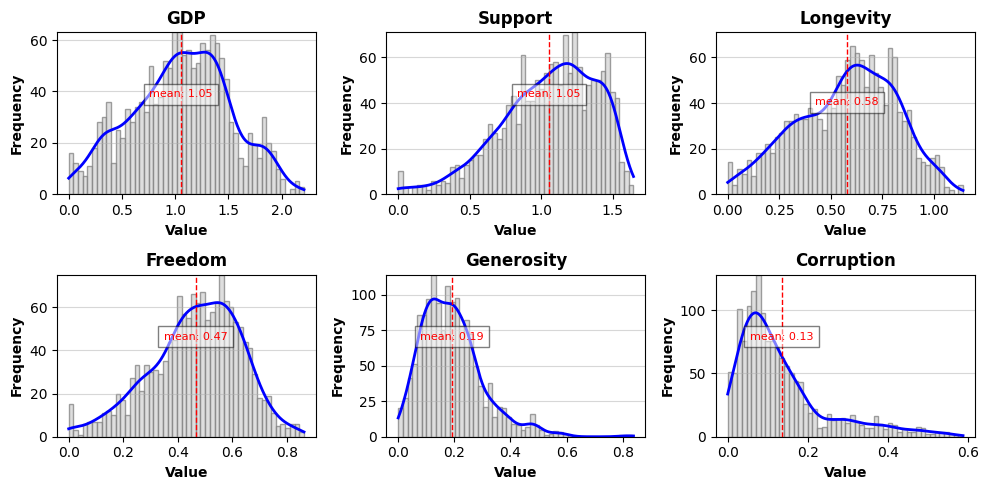

In [5]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import plotly.offline as pyo
import matplotlib.pyplot as plt
import math
import plotly.io as pio
import numpy as np
import seaborn as sns
import pylab as pl
from scipy import stats

happiness_factor_columns = [
  'gdp_per_capita',
  'social_support',
  'healthy_life_expectancy',
  'freedom_to_make_life_choices',
  'generosity',
  'perceptions_of_corruption'
]

factor_labels = [
  'GDP', 
  'Support', 
  'Longevity',                  
  'Freedom', 
  'Generosity', 
  'Corruption']

fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(10, 5))

ax = axes.flatten()
max_freq = 0
for i, col in enumerate(happiness_factor_columns):
  data = happiness_data[col]
  freq, bins, patches = ax[i].hist(data, bins=50, alpha=0.75, color='lightgrey', edgecolor='grey')
  max_freq = max(max_freq, freq.max())
  ax[i].set_title(f'{factor_labels[i]}', fontweight='bold')
  ax[i].set_xlabel('Value', fontweight='bold')
  ax[i].set_ylabel('Frequency', fontweight='bold')
  # Set the y-axis limit to be the same for all subplots
  ax[i].set_ylim(0, max_freq)
  # grid lines
  ax[i].grid(axis='y', alpha=0.5)

  # kde plot
  # kde = data.kurtosis()
  kde = stats.gaussian_kde(data)
  x_kde = np.linspace(data.min(), data.max(), 1000)
  
  # scale the KDE values to match the histogram frequency scale
  y_kde = kde(x_kde) * len(data) * (bins[1] - bins[0])
  ax[i].plot(x_kde, y_kde, color='blue', linewidth=2)

  # vertical line at the mean
  mean = np.mean(data)
  ax[i].axvline(mean, color='red', linestyle='dashed', linewidth=1)
  ax[i].text(mean, (freq.max())*0.6, f'mean: {mean:.2f}', color='red',
    fontsize=8, bbox=dict(facecolor='white', alpha=0.5), ha='center')

plt.tight_layout()
plt.show()



#### Boxplot

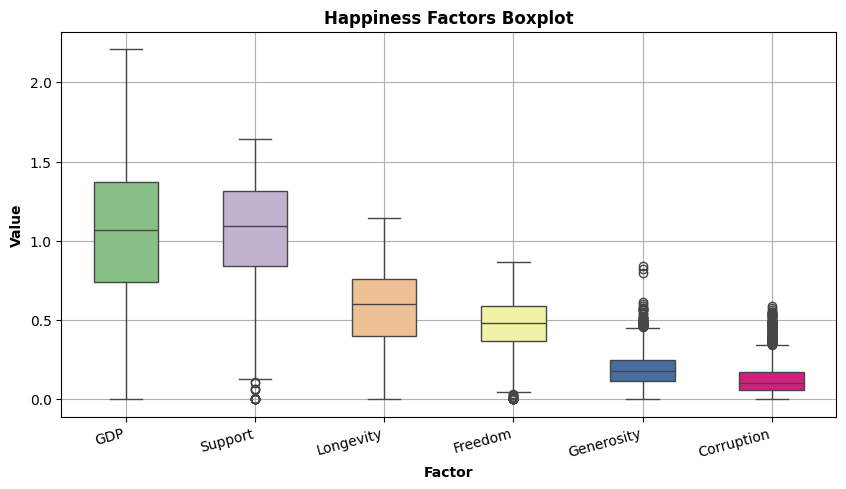

In [6]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 5))
boxplot_data = happiness_data[happiness_factor_columns]
sns.boxplot(data=boxplot_data, orient="v", palette="Accent", width=0.5)

plt.xlabel("Factor", fontweight='bold')
plt.ylabel("Value", fontweight='bold')
plt.title("Happiness Factors Boxplot", fontweight='bold')
plt.grid(True)
plt.xticks(ticks=range(0, 6), labels=factor_labels, rotation=15, ha='right')

plt.show()


### Correlation Analysis
> The correlation between happiness scores and factors will be analyzed using 
- Pair plot to visualize the relationships between different factors and happiness scores.
- Heatmap to visualize the correlation between different factors and happiness scores.
- Correlation matrix to visualize the correlation between different factors and happiness scores.

#### Pair Plot

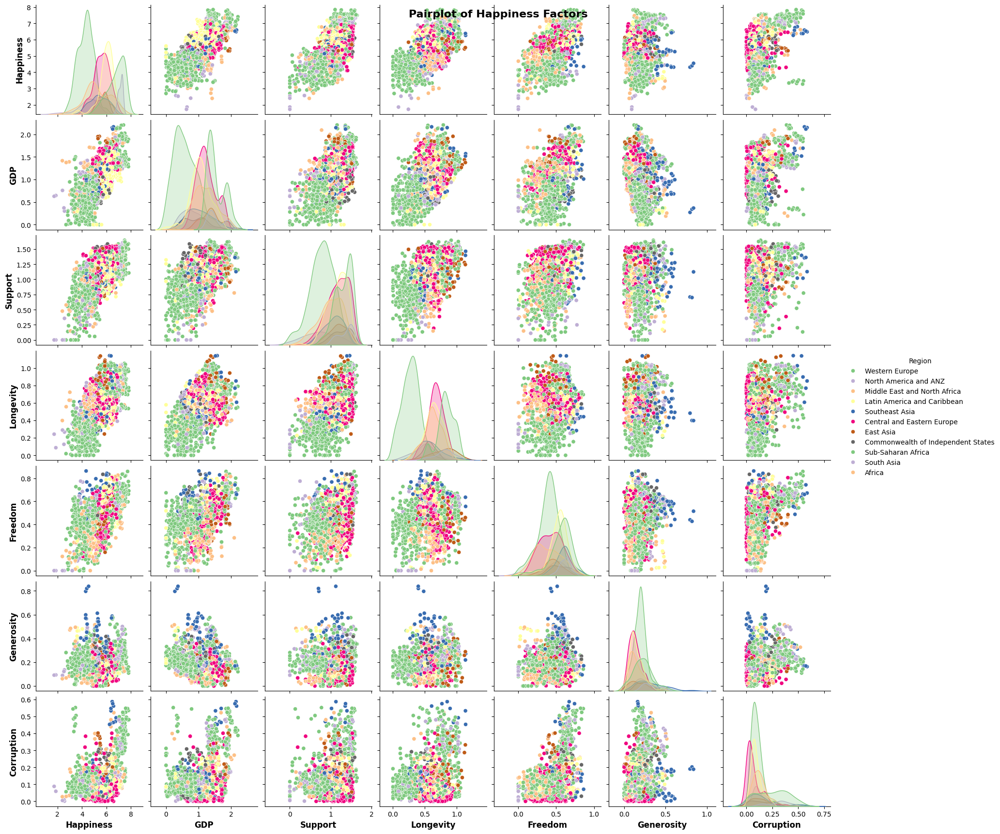

In [7]:

pair_plot_columns = ['region', 'happiness_score'] + happiness_factor_columns
pair_plot_labels = ['Region', 'Happiness'] + factor_labels
label_mapping = dict(zip(pair_plot_columns, pair_plot_labels))
pair_plot_data = happiness_data[pair_plot_columns].rename(columns=label_mapping)
hue = 'Region'
sns.pairplot(pair_plot_data, diag_kind='kde', hue=hue, palette='Accent')
#plt.subplots_adjust(top=0.)
plt.suptitle("Pairplot of Happiness Factors", fontweight='bold', fontsize=16)

# Customize font size and weight for axis labels
for ax in plt.gcf().axes:
    ax.set_xlabel(ax.get_xlabel(), fontsize=12, fontweight='bold')
    ax.set_ylabel(ax.get_ylabel(), fontsize=12, fontweight='bold')

plt.show()

#### Heatmap
- the chart shows the correlation between happiness scores and factors. The color intensity indicates the strength of the correlation, with darker colors representing stronger correlations. The chart also includes a color bar to indicate the range of correlation values.
- As the chart shows, the most correlated factors with happiness scores are GDP per capita (**0,71**), social support(**0.66**), and life expectancy(**0.68**). The least correlated factors are generosity(**0.08**) and perceptions of corruption(**0.42**).

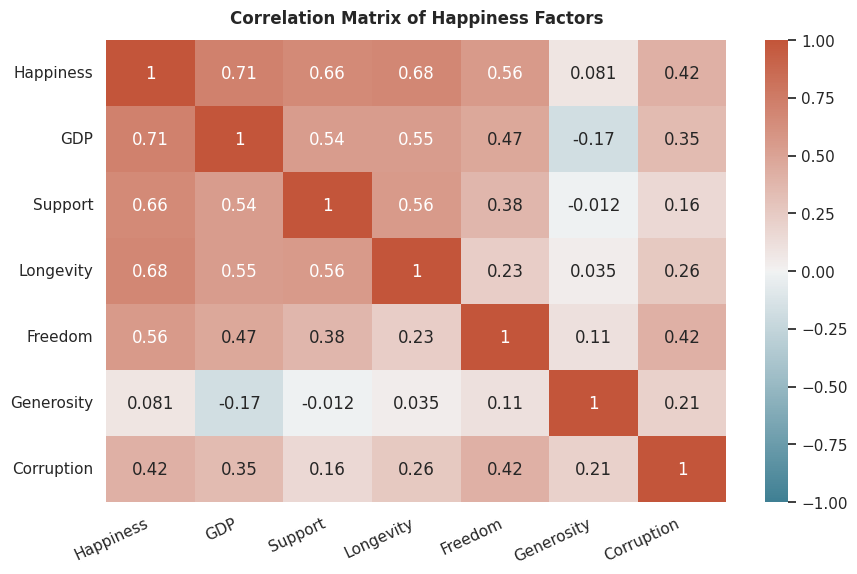

In [8]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Calculate the correlation matrix
corr_data = happiness_data[['happiness_score']+happiness_factor_columns]
corr_labels = ['Happiness'] + factor_labels
corr_matrix = corr_data.corr()

# Set the color palette
palette = sns.diverging_palette(220, 20, as_cmap=True)

# Plot the correlation matrix using a heatmap
plt.figure(figsize=(10,6))
sns.set(font_scale=1)
#heatmap = sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
heatmap = sns.heatmap(corr_matrix, annot=True, cmap=palette, vmin=-1, vmax=1)
heatmap.set_title('Correlation Matrix of Happiness Factors', fontdict={'fontsize':12}, pad=12, fontweight='bold')
plt.xticks(ticks= np.linspace(0.5, 6.5, 7), labels=corr_labels, rotation=25, ha='right')
plt.yticks(ticks=np.linspace(0.5, 6.5, 7), labels=corr_labels)

plt.show()


#### Radar Chart
> The radar chart is used to visualize the distribution of happiness scores and factors for different countries and regions. It provides a clear view of the factors that contribute to happiness across different countries and regions. as the chart shows, the most significant factors that contribute to happiness are **GDP per capita**, **social support**, and **life expectancy**. The least significant factors are **generosity** and **perceptions of corruption**.

![Explained by Which Happiness Factors](./assets/whr_factors_radar.png)

In [9]:

# Create radar chart
fig = go.Figure()

radar_data = happiness_data[happiness_factor_columns]
for i in range(len(radar_data)):
    fig.add_trace(go.Scatterpolar(
        r=radar_data.iloc[i, 0:].values,
        theta=factor_labels,
        fill='toself',
        name=happiness_data.iloc[i, 0]
    ))

fig.update_layout(
    polar=dict(
      radialaxis=dict(
          visible=True,
          range=[0, 2.5]
      )),
    title={'text': "Explained by Happiness Factors",
      'x': 0.5,
      'xanchor': 'center',
      'font': {'size': 20, 'family': 'Arial', 'color': 'black'}}

    
)

fig.show()


#### Polar Chart
> The polar chart is used to visualize the distribution of happiness scores and factors for different countries and regions. It provides a clear view of the factors that contribute to happiness across different countries and regions. as the chart shows, the most significant factors that contribute to happiness are **GDP per capita**, **social support**, and **life expectancy**. The least significant factors are **generosity** and **perceptions of corruption**.

> In this plot, I normalized the factors data to have a common scale for better comparison (see below code snipet). **When double click on the country name in the legend**, it will show the factors that contribute to happiness for that country. This allows for a more direct comparison of the factors that contribute to happiness for the country of interest. 

```python
for col in happiness_factor_columns:
    polar_data[col] = polar_data[col] * (polar_data['happiness_score'].max() / polar_data[col].max())
```



![Explained by Which Happiness Factors (Normalized)](./assets/whr_factors_polar.png)

In [10]:
import plotly.express as px
polar_data = happiness_data.copy()
polar_data = polar_data[['country', 'happiness_score'] + happiness_factor_columns]
for col in happiness_factor_columns:
    polar_data[col] = polar_data[col] * (polar_data['happiness_score'].max() / polar_data[col].max())
    
fig = go.Figure()

for i in range(len(polar_data)):
    fig.add_trace(go.Scatterpolar(
        r=polar_data.iloc[i, 1:].values,
        theta=factor_labels,
        fill='toself',
        name=polar_data['country'][i]
    ))

fig.update_layout(
    polar=dict(
        radialaxis=dict(
            visible=True,
            range=[0, polar_data['happiness_score'].max()]
        )),
    title={'text': "Polar Chart of Happiness Factors",
           'x': 0.5,
           'xanchor': 'center',
           'font': {'size': 20, 'family': 'Arial', 'color': 'black'}}
)

# fig.update_traces(fillcolor='rgba(0, 100, 80, 0.2)', line=dict(color='rgba(0, 100, 80, 1)'))

fig.show()


### Other Analysis

> With the fundamental analysis and visualization of the happiness factors, I also explored the folllowing:
- Who are the top 10 happiest countries over the years?
- Who are the most improved countries? 
  - What are the factors that contributed to their improvement?
- Who are the least improved countries? 
  - What are the factors that contributed to their decline?


#### Top 10 Happiest Countries
![Top 10 Happiest Countries](./assets/whr_top10happiest.png)

In [11]:
# Top n happiest countries for each year
N=10

top_n_df = happiness_data.groupby('Year', group_keys=False)[['Year', 'country', 'happiness_score']] \
  .apply(lambda x: x.nlargest(N, columns='happiness_score')) \
  .reset_index(drop=True)
  
  #.reset_index(drop=True).rename(columns={'happiness_score': 'Happiness Score'})

# Plot ribbon chart to show the top 20 happiest countries over the years
top_n_fig = px.line(top_n_df, x='Year', y='happiness_score', color='country', title=f'Top {N} Happiest Countries Over the Years')

top_n_fig.update_traces(mode='lines+markers')
top_n_fig.update_layout(title={'text': f'Top {N} Happiest Countries Over the Years',
                               'x': 0.5,
                               'xanchor': 'center',
                               'font': {'size': 20, 'family': 'Arial', 'color': 'black', 'weight': 'bold'}},
                        xaxis_title='Year',
                        yaxis_title='Happiness Score',
                        legend_title='Country')



top_n_fig.show()

#### Most Improved and Declined Countries
> The most improved and declined countries in terms of happiness scores will be visualized using a scatterplot chart with trace linked year to year. This chart will provide insights into the countries that have made significant progress or faced challenges in terms of happiness and well-being over the years.

#### Most Improved Countries
![Most Improved Country Year-over-Year](./assets/whr_most_improved.png)

In [12]:
from plotly.subplots import make_subplots

most_improved_data = happiness_data.copy()

# Calculate the year-over-year improvement in happiness score for each country
most_improved_data['score_change'] = most_improved_data.groupby('country')['happiness_score'].diff()

# Other calculation of the improvement in happiness score for each country
# For over the years, the score change is calculated as the difference between the year and the first year
# so max().idxmax() will give the country with the most improvement, not year-over-year
# most_improved_data['score_change'] = most_improved_data.groupby('country')['happiness_score'] \
#   .transform(lambda x: x - x.iloc[0])
# to find the country with the most improvement in happiness score
# most_improved_country = most_improved_data.groupby('country')['score_change'].max().idxmax()

# Find the country with the most improvement year-over-year in happiness score
most_improved_country = most_improved_data.groupby('country')['score_change'].sum().idxmax()

# Filter data for the most improved country
most_improved_df = happiness_data[happiness_data['country'] == most_improved_country]

# Plot the improvement in happiness score over the years for the most improved country
fig = make_subplots(rows=2,
                    cols=1,
                    shared_xaxes=True,
                    vertical_spacing=0.30,
                    subplot_titles=(f'Happiness Score Over the Years for {most_improved_country}',
                                    f'Factors Contributing to the Improvement'))

# Plot the improvement in happiness score over the years for the most improved country
fig.add_trace(go.Scatter(x=most_improved_df['Year'],
                         y=most_improved_df['happiness_score'],
                         mode='lines+markers',
                         name='Happiness Score'),
              row=1,
              col=1)

# Add traces for each factor to explain the improvement
colors = px.colors.qualitative.Plotly
for i, factor in enumerate(['gdp_per_capita', 'social_support', 'healthy_life_expectancy',
                            'freedom_to_make_life_choices', 'generosity', 'perceptions_of_corruption']):
    fig.add_trace(go.Scatter(x=most_improved_df['Year'],
                             y=most_improved_df[factor] * (most_improved_df['happiness_score'].max() / most_improved_df[factor].max()),
                             mode='lines+markers',
                             name=factor.replace('_', ' ').title(),
                             line=dict(color=colors[i % len(colors)])),
                  row=2,
                  col=1)

# Update layout to center the title and make it bold
fig.update_layout(title={'text': f'Most Improved Country: {most_improved_country} (Happiness Score)',
                         'x': 0.5,
                         'xanchor': 'center',
                         'font': {'size': 20}},
                  xaxis_title='Year',
                  yaxis_title='Score',
                  legend_title='Factors')

fig.show()


#### Least Improved Countries 
> the least improved countries are those that have faced significant challenges in terms of happiness and well-being. It is meant to provide insights into factors or events that may have contributed to the decline in happiness scores. And in the hope to raise awareness and encourage positive changes.

![Least Improved Country Year-over-Year](./assets/whr_least_improved.png)

In [13]:
from plotly.subplots import make_subplots



least_improved_data = happiness_data.copy()

# Calculate the year-over-year improvement in happiness score for each country
least_improved_data['score_change'] = least_improved_data.groupby('country')['happiness_score'].diff()
least_improved_country = least_improved_data.groupby('country')['score_change'].sum().idxmin()
least_improved_df = least_improved_data[least_improved_data['country'] == least_improved_country]


# Plot the improvement in happiness score over the years 
fig = make_subplots(rows=2,
                    cols=1,
                    shared_xaxes=True,
                    vertical_spacing=0.30,
                    subplot_titles=(f'Happiness Score Over the Years for {least_improved_country}',
                                    f'Factors Reducing the Improvement'))

# Plot the improvement in happiness score over the years for the most improved country
fig.add_trace(go.Scatter(x=least_improved_df['Year'],
                         y=least_improved_df['happiness_score'],
                         mode='lines+markers',
                         name='Happiness Score'),
              row=1,
              col=1)

# Add traces for each factor to explain the improvement
colors = px.colors.qualitative.Plotly
for i, factor in enumerate(['gdp_per_capita', 'social_support', 'healthy_life_expectancy',
                            'freedom_to_make_life_choices', 'generosity', 'perceptions_of_corruption']):
    fig.add_trace(go.Scatter(x=least_improved_df['Year'],
                             y=least_improved_df[factor] * (abs(least_improved_df['happiness_score'].min()) / abs(least_improved_df[factor].min())),
                             mode='lines+markers',
                             name=factor.replace('_', ' ').title(),
                             line=dict(color=colors[i % len(colors)])),
                  row=2,
                  col=1)

# Update layout to center the title and make it bold
fig.update_layout(title={'text': f'Least Improved Country: {least_improved_country} (Happiness Score)',
                         'x': 0.5,
                         'xanchor': 'center',
                         'font': {'size': 20}},
                  xaxis_title='Year',
                  yaxis_title='Score',
                  legend_title='Factors')

fig.show()


### Conclusion
> Yes, money can buy happiness, but it is not the only factor that contributes to happiness. This exploratory analysis and visualization of the World Happiness Report data from 2015 to 2024 hightlight the key factors that contribute to happiness are GDP per capita, social support, and life expectancy. Additionally, the analysis presented trends and patterns in happiness over the years, as well as the most improved and declined countries in terms of happiness scores. 